<a href="https://colab.research.google.com/github/pisano-andrea/Progetto_Fesi_PisanoA/blob/main/Progetto_Fesi_Finale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup e file Wav

Come le funzioni di Plotting che vedremo dopo viene inserito all'inizio cosicché non diano errori gli esperimenti fatti all'interno del pitch

In [40]:
import os
import numpy as np
import librosa
import librosa.display
import soundfile as sf
import matplotlib.pyplot as plt
import IPython
import warnings
# warnings.filterwarnings("ignore")
%matplotlib inline
from sklearn.decomposition import NMF
from scipy.signal import butter, sosfilt

# Parametri globali
BASEPATH = '/components'
WAVNAME = BASEPATH + '/orchestra.wav'     # file di input
OUT_DIR = BASEPATH + '/out_components'    # cartella output
SR_DEFAULT = 44100            # sample rate default
NMF_COMPONENTS = 4            # componente NMF di default
INSTRUMENT_NAMES = ['Violino', 'Basso', 'Batteria', 'Chitarra']
os.makedirs(OUT_DIR, exist_ok=True)

def ensure_temp_exists(wavname=WAVNAME, sr=SR_DEFAULT):
    if os.path.exists(wavname):
        y, sr = librosa.load(wavname, sr=None, mono=True)
        print(f"Trovato {wavname}: durata {len(y)/sr:.2f}s")
        return y, sr

    print(f"{wavname} non trovato — genero un segnale di prova e lo salvo come {wavname}.")
    duration = 10.0
    t = np.linspace(0, duration, int(sr * duration), endpoint=False)


    # basso (110 Hz)
    bass = 0.6 * np.sin(2 * np.pi * 110 * t)


    # violino (fondamentale + armoniche)
    violin = 0.3 * np.sin(2 * np.pi * 440 * t)
    violin += 0.15 * np.sin(2 * np.pi * 880 * t)
    violin += 0.05 * np.sin(2 * np.pi * 1320 * t)


    # chitarra (semplice arpeggio di due note)
    guitar = 0.25 * (np.sin(2 * np.pi * 196 * t) + 0.5 * np.sin(2 * np.pi * 293.66 * t))


    # batteria (impulsi ogni 0.5s con decadimento)
    impulse = np.zeros_like(t)
    for i in range(0, int(duration * 2)):
        idx = int(i * 0.5 * sr)
        if idx < len(t):
            l = min(len(t) - idx, int(0.05 * sr))
            impulse[idx:idx + l] += np.exp(-np.linspace(0, 5, l))
    impulse *= 0.4


    y = bass + violin + guitar + impulse
    y = y / np.max(np.abs(y)) * 0.9
    sf.write(wavname, y, sr)
    print(f"Segnale di prova salvato come {wavname} (durata {duration}s)")
    return y, sr

y, sr = ensure_temp_exists(WAVNAME, SR_DEFAULT)
IPython.display.Audio(WAVNAME)

Trovato /components/orchestra.wav: durata 10.00s


In [41]:
from google.colab import drive
drive.mount('/content/drive')

Google Drive è già montato in /content/gdrive_new. Nessuna azione necessaria.


# Analisi e Separazione di Componenti Musicali tramite NMF
### **Pitch del Progetto**  
**Autore:** Pisano Andrea

---

## Obiettivo del progetto

- **Dati in input un segnale audio musicale**, studiarlo e decomporlo nelle sue principali componenti.
- **Nel caso non venga fornito un segnale audio** il codice genererà un file 'orchestra.wav' generato tramite la libreria 'librosa' che simulerà un'orchestra composta da 4 strumenti
- Come funziona il progetto:  
  Da una registrazione orchestrale ('orchestra.wav'), estrarre componenti riconducibili a:  
  - violini  
  - percussioni  
  - fiati  
  - basso  
  (o più in generale: parti con pattern temporali/spettrali distinti)

In aggiunta, il progetto include un **secondo esperimento**:
- Dopo aver scomposto il segnale mediante NMF, **Rimuovere una componente specifica** dal mix originale semplicemente modificando una variabile nel codice.

---

## Elementi teorici essenziali

### 🔹 Trasformata di Fourier
Strumento fondamentale per passare dal dominio del tempo al dominio delle frequenze.

**Nel notebook:**  
La trasformata di Fourier è utilizzata indirettamente tramite la STFT per analizzare il contenuto in frequenza del segnale musicale.

**Perché è necessaria:**  
I segnali musicali sono più interpretabili nel dominio delle frequenze, dove è possibile distinguere componenti armoniche e strutture percussive.

---

### 🔹 DFT (Discrete Fourier Transform)
Versione discreta della trasformata di Fourier, applicabile ai segnali digitali.

**Nel notebook:**  
La DFT è alla base del calcolo della STFT (`librosa.stft`), che applica una DFT locale su finestre temporali del segnale.

**Perché è necessaria:**  
Permette di ottenere una rappresentazione numerica dello spettro, indispensabile per il filtraggio e la decomposizione del segnale.

---

### 🔹 STFT (Short Time Fourier Transform)
Permette di analizzare il contenuto in frequenza in finestre temporali sovrapposte.

**Nel notebook:**  
Usata per:
- costruire lo spettrogramma del segnale
- applicare NMF
- ricostruire le componenti audio tramite ISTFT

**Perché è necessaria:**  
I segnali musicali non sono stazionari: la STFT consente di osservare come le frequenze evolvono nel tempo.

---

### 🔹 Filtraggio 1D e 2D
- **Filtri 1D** → applicati direttamente al segnale nel tempo  
- **Filtri 2D** → applicati allo spettrogramma

**Nel notebook:**  
Il filtraggio avviene nello spazio tempo–frequenza tramite maschere spettrali (Wiener masking).

**Perché è necessario:**  
Consente di isolare o attenuare specifiche componenti del segnale senza distruggere l’informazione temporale.

---

### 🔹 NMF (Non-negative Matrix Factorization)
Tecnica che decompone lo spettrogramma in componenti interpretabili.

**Nel notebook:**  
Lo spettrogramma viene scomposto in:
- **W**: basi spettrali
- **H**: attivazioni temporali

**Perché è necessaria:**  
La non-negatività garantisce componenti fisicamente interpretabili, associate a strumenti o sorgenti sonore.


---






### 🔹 Funzioni di Plotting

NOTA:
Le seguenti funzioni sono utilizzate sia nel Pitch che nei Details, vengono inserite pure qua affinché gli esperimenti funzionino e non dia errore

In [42]:
def nmf_decompose(y, sr, n_components=4, n_fft=2048, hop_length=512,
                  init='random', random_state=0, max_iter=200):
    # Decomposizione NMF dello spettrogramma del segnale.
    # Ritorna:
    # - components: magnitudini mascherate
    # - reconstructed_signals: segnali temporali ricostruiti

    S = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
    mag = np.abs(S)
    phase = np.angle(S)

    model = NMF(
        n_components=n_components,
        init=init,
        random_state=random_state,
        max_iter=max_iter
    )

    W = model.fit_transform(mag)
    H = model.components_
    total_approx = np.dot(W, H)

    components = []
    reconstructed_signals = []

    for k in range(n_components):
        S_k = np.outer(W[:, k], H[k, :])
        mask = S_k / (total_approx + 1e-10)

        components.append(mask * mag)

        S_k_complex = (mask * mag) * np.exp(1j * phase)
        y_k = librosa.istft(S_k_complex, hop_length=hop_length)

        reconstructed_signals.append(y_k)

    return components, reconstructed_signals


def remove_component_from_mix(y_mix, y_component):
    #Rimuove una componente dal mix originale tramite sottrazione
    min_len = min(len(y_mix), len(y_component))
    return y_mix[:min_len] - y_component[:min_len]

def plot_signal_time(y, sr, title='signal', color='b', savepath=None):
    t = np.linspace(0, len(y)/sr, len(y))
    plt.figure(figsize=(12,3))
    plt.plot(t, y, color=color, label=title)
    plt.xlabel('t [s]')
    plt.legend()
    plt.grid()
    plt.title(title)
    plt.tight_layout()
    if savepath:
        plt.savefig(savepath, dpi=150)
    plt.show()

## Esperimenti dimostrativi

### **Esperimento 1 — Separazione delle componenti**
Parametri modificabili:
- `n_components` (numero di componenti da estrarre)

Cosa mostra:
- Come possiamo separare e scomporre un segnale più grande in più elementi

/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


Componente 1


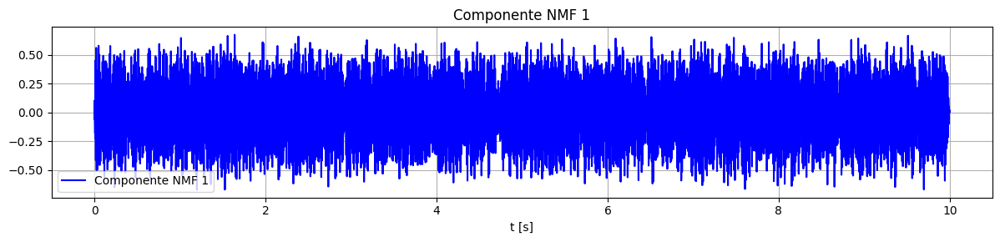

Componente 2


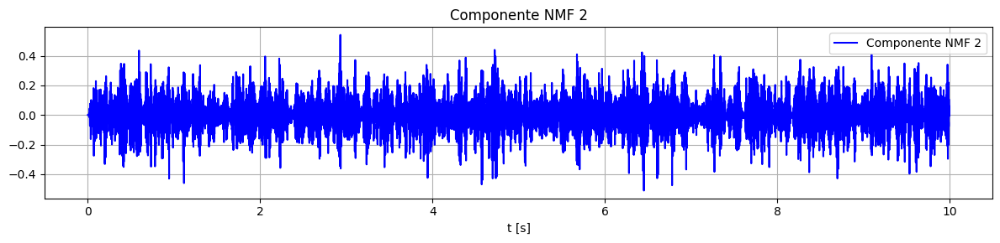

Componente 3


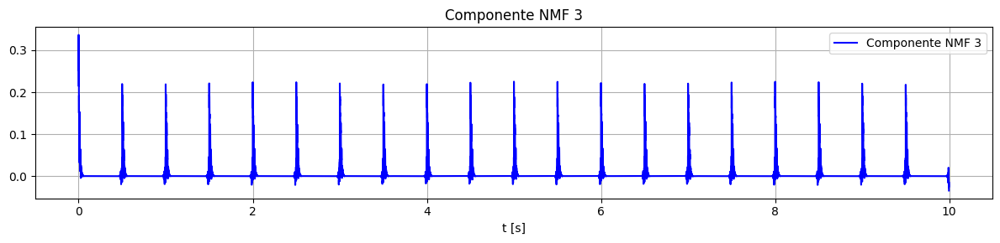

Componente 4


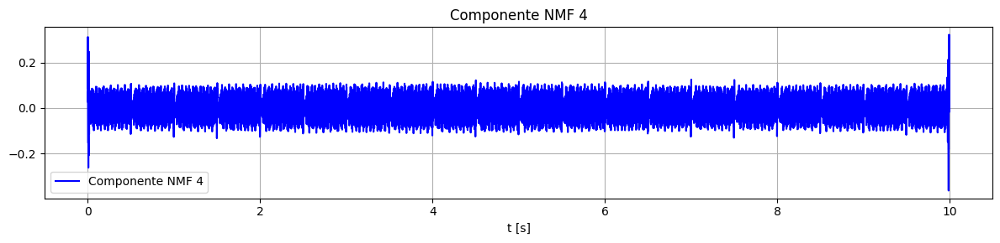

In [43]:
# Parametro modificabile
n_components = 4

components, recs = nmf_decompose(y, sr, n_components=n_components)

for i, y_k in enumerate(recs):
    print(f"Componente {i+1}")
    display(IPython.display.Audio(y_k, rate=sr))
    plot_signal_time(y_k, sr, f'Componente NMF {i+1}')



---

### **Esperimento 2 — Rimozione di una componente**
Variabile da modificare:
```python
component_to_remove = 0  # 0 = prima componente, 1 = seconda, ...

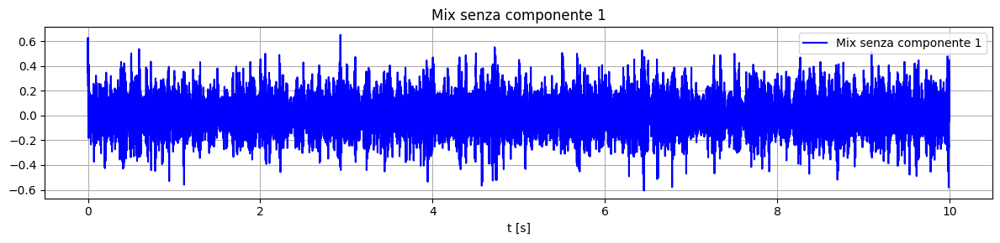

In [44]:
# Parametro modificabile
component_to_remove = 0  # 0 = prima componente, 1 = seconda, ...

out_minus = remove_component_from_mix(y, recs[component_to_remove])

display(IPython.display.Audio(out_minus, rate=sr))
plot_signal_time(out_minus, sr, f'Mix senza componente {component_to_remove + 1}')


---
---
---

# DETAILS — Introduzione

## Collaboratori
Il progetto è stato svolto individualmente.  
Eventuali discussioni esterne si sono limitate alla revisione della teoria e alla validazione dei risultati.

---

## Obiettivo
L’obiettivo principale è la **separazione non supervisionata delle componenti musicali** tramite NMF.

L’obiettivo comprende:
- sperimentazione con diversi parametri (n_components)
- valutazione della generalità del metodo su differenti segnali
- rimozione selettiva di una componente
- comprensione approfondita di Fourier, STFT, filtraggio e spettrogrammi


# 🔹  Upload o Creazione e Visualizzazione del file '.wav'
All'interno di questa parte di codice si vuole creare un segnale musicale da poter utilizzare per il nostro laboratorio. Tutto questo può essere realizzato con l'utilizzo della libreria "Librosa" che ci permette di creare dei segnali che simulano gli strumenti che andremo a dividere all'interno del codice.
Al suo interno fa prima un controllo, perché nel caso esista già un file .wav dato in input non crea nulla e andremo ad analizzare il file già dato, altrimenti ne creiamo uno completamente nuovo.

---

Importante: In questa parte di codice la funzione fa un upload e rende visualizzabile il segnale, non lo crea siccome questo check viene fatto nella parte di pitch ed il codice viene ripetuto

---

Questa parte di codice è stata creata con l'ausilio di chatgpt.



In [45]:
def ensure_temp_exists(wavname=WAVNAME, sr=SR_DEFAULT):
    if os.path.exists(wavname):
        y, sr = librosa.load(wavname, sr=None, mono=True)
        print(f"Trovato {wavname}: durata {len(y)/sr:.2f}s")
        return y, sr

    print(f"{wavname} non trovato — genero un segnale di prova e lo salvo come {wavname}.")
    duration = 10.0
    t = np.linspace(0, duration, int(sr * duration), endpoint=False)


    # basso (110 Hz)
    bass = 0.6 * np.sin(2 * np.pi * 110 * t)


    # violino (fondamentale + armoniche)
    violin = 0.3 * np.sin(2 * np.pi * 440 * t)
    violin += 0.15 * np.sin(2 * np.pi * 880 * t)
    violin += 0.05 * np.sin(2 * np.pi * 1320 * t)


    # chitarra (semplice arpeggio di due note)
    guitar = 0.25 * (np.sin(2 * np.pi * 196 * t) + 0.5 * np.sin(2 * np.pi * 293.66 * t))


    # batteria (impulsi ogni 0.5s con decadimento)
    impulse = np.zeros_like(t)
    for i in range(0, int(duration * 2)):
        idx = int(i * 0.5 * sr)
        if idx < len(t):
            l = min(len(t) - idx, int(0.05 * sr))
            impulse[idx:idx + l] += np.exp(-np.linspace(0, 5, l))
    impulse *= 0.4


    y = bass + violin + guitar + impulse
    y = y / np.max(np.abs(y)) * 0.9
    sf.write(wavname, y, sr)
    print(f"Segnale di prova salvato come {wavname} (durata {duration}s)")
    return y, sr

y, sr = ensure_temp_exists(WAVNAME, SR_DEFAULT)
IPython.display.Audio(WAVNAME)

Trovato /components/orchestra.wav: durata 10.00s



#  🔹  Funzioni di Plotting
 Contiene funzioni per disegnare waveform e spettrogrammi

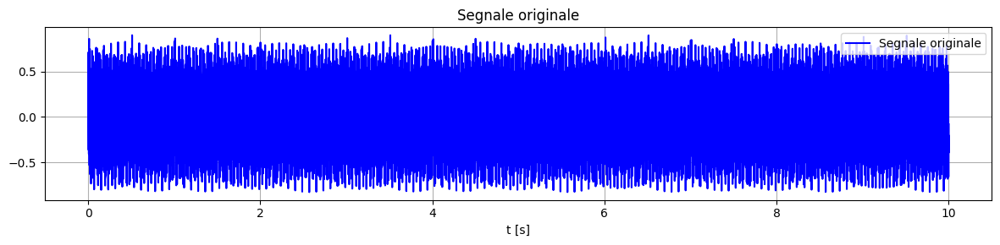

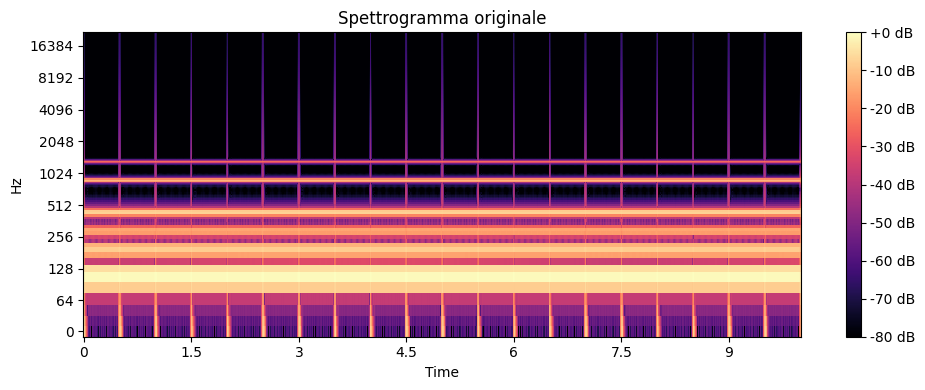

In [35]:
def plot_waveform(y, sr, title="Waveform"):
    plt.figure(figsize=(12,3))
    librosa.display.waveshow(y, sr=sr)
    plt.title(title)
    plt.tight_layout()
    plt.show()


def plot_spectrogram(S, sr, hop_length=512, y_axis='log', title='Spettrogramma'):
    plt.figure(figsize=(10,4))
    librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                             sr=sr, hop_length=hop_length,
                             y_axis=y_axis, x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title(title)
    plt.tight_layout()
    plt.show()


def plot_signal_time(y, sr, title='signal', color='b', savepath=None):
    # vettore tempo
    t = np.linspace(0, len(y)/sr, len(y))
    plt.figure(figsize=(12,3))
    plt.plot(t, y, '-b', label=title)
    plt.xlabel('t [s]')
    plt.legend()
    plt.grid()
    plt.title(title)
    plt.tight_layout()
    if savepath:
        plt.savefig(savepath, dpi=150)
    plt.show()

# aggiunto da Gemini: Ensure the output directory exists before saving plots
os.makedirs(OUT_DIR, exist_ok=True)
# plotting del segnale originale
plot_signal_time(y, sr, 'Segnale originale', savepath=os.path.join(OUT_DIR, 'original_signal.png'))
S = librosa.stft(y)
plot_spectrogram(np.abs(S), sr, title='Spettrogramma originale')

## *Parte Teorica* — Fourier, STFT e rappresentazioni tempo-frequenza



### 1) Segnale discreto nel dominio del tempo
Un segnale audio campionato è una sequenza discreta \(x[n]\) definita come:
$$x[n] = x(n T_s),\qquad T_s=\frac{1}{f_s}$$
dove \(f_s\) è la frequenza di campionamento (es. 44100 Hz). La waveform è semplicemente la rappresentazione grafica di \(x[n]\) in funzione del tempo.

---

### 2) Trasformata di Fourier discreta (DFT)
La DFT converte un frame finito di \(N\) campioni in uno spettro discreto:
$$X[k] = \sum_{n=0}^{N-1} x[n]\,e^{-j 2\pi \frac{k n}{N}},\quad k=0,\dots,N-1$$
Nel codice usiamo l'algoritmo FFT (Fast Fourier Transform) che calcola la DFT in \(O(N\log N)\).

---

### 3) Short-Time Fourier Transform (STFT) e spettrogramma
Per analizzare la variazione spettrale nel tempo si applica la FT a finestre mobili:
$$\mathbf{X(t, \omega) = \sum_{n} x[n]\,w[n-t]\,e^{-j\omega n}}$$
dove \(w[\cdot]\) è una finestra (es. Hann). Lo spettrogramma è la magnitudine (o magnitudo in dB) della STFT:
$$\text{Spectrogram}(t,f) = 20\log_{10}|X(t,f)|$$
Parametri importanti nel codice:
- `n\_fft`: dimensione della finestra (maggiore → migliore risoluzione in frequenza, peggiora risoluzione in tempo)
- `hop\_length`: step tra finestre (influenza il dettaglio temporale e il tempo di calcolo)
- `window`: forma della finestra (Hann, Hamming, ...)

Nel codice: `librosa.stft(y, n_fft=2048, hop_length=512)` crea la matrice STFT; `librosa.amplitude_to_db` converte in dB per la visualizzazione.

---

### 4) Interpretazione pratica per HPSS/NMF
- **Linee orizzontali** nello spettrogramma ⇢ componenti armoniche (note sostenute).  
- **Linee verticali** ⇢ transienti/percussioni.  
Queste caratteristiche sono quelle che algoritmi come HPSS sfruttano per separare le fonti; NMF lavora sulla matrice delle magnitudini ricercando basi spettrali \(W\) e attivazioni \(H\) tali che:
$$|S| \approx W\,H$$
---

### 5) Conversione magnitudo → dB
Per la visualizzazione si usa la scala logaritmica dei valori di magnitudo:
$$20\log_{10}(|S|)$$
Questo enfatizza componenti deboli e rende lo spettrogramma più leggibile all’occhio umano.

---

### 6) Nota su risoluzione e artefatti
- Trade-off tempo/frequenza: scelta di `n_fft` e `hop_length` è cruciale.  
- L’ISTFT (ricostruzione) richiede attenzione alla fase: spesso si usa la fase originale quando si modifica solo la magnitudo.  
- Filtri troppo netti e maschere hard possono generare *ringing* e artefatti nel dominio del tempo.

---

### Riferimenti
- D. Oppenheim, R. Schafer — *Discrete-Time Signal Processing*  
- Librosa documentation — `stft`, `istft`, `amplitude_to_db`


# 🔹  HPSS - Separazione Armonica/Percussiva
Separa il segnale in componenti armoniche e percussive usando HPSS.
- y: segnale audio
- margin, kernel_size: parametri che regolano la separazione


 HPSS usa differenze tra variazioni temporali vs. variazioni in frequenza.


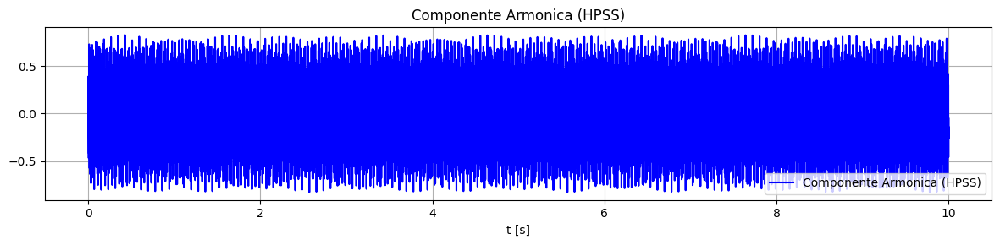

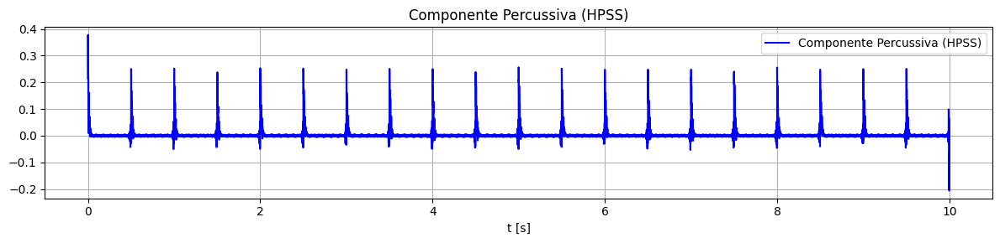

In [36]:
def hpss_separate(y, margin=1.0, kernel_size=31):
    y_h, y_p = librosa.effects.hpss(y, kernel_size=kernel_size, margin=margin)
    return y_h, y_p


# Esegui HPSS e mostra i risultati
y_h, y_p = hpss_separate(y)
IPython.display.display(IPython.display.Audio(y_h, rate=sr))
plot_signal_time(y_h, sr, 'Componente Armonica (HPSS)')
IPython.display.display(IPython.display.Audio(y_p, rate=sr))
plot_signal_time(y_p, sr, 'Componente Percussiva (HPSS)')

# *Osservazioni*

È bene notare la differenza tra i due grafici di HPSS. Nonostante entrambi siano i grafici di "strumenti" diversi (tra virgolette siccome sono comunque strumenti sintetici emulati dalla libreria librosa), la parte armonica è molto più presente.

Comunque ci servirà osservare per bene questi due grafici per vedere come il singolo strumento si comporta (diciamo che stiamo facendo una ramificazione del segnale originale)


---






# 🔹  NMF - Non-negative Matrix Factorization
Applica NMF per separare lo spettrogramma in n componenti sorgenti.

---



Questa funzione ci permette di ottenere delle maschere per componente e i nostri segnali ricostruiti come li volevamo

/usr/local/lib/python3.12/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(


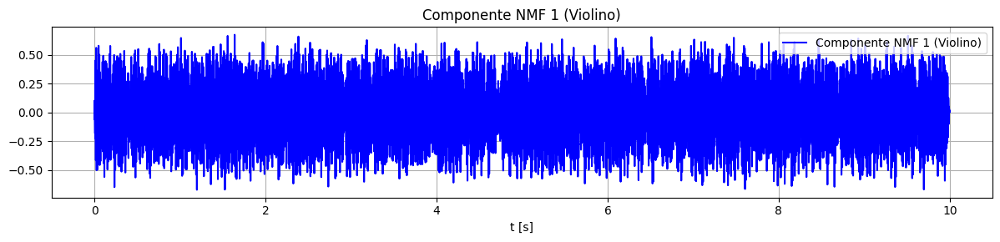

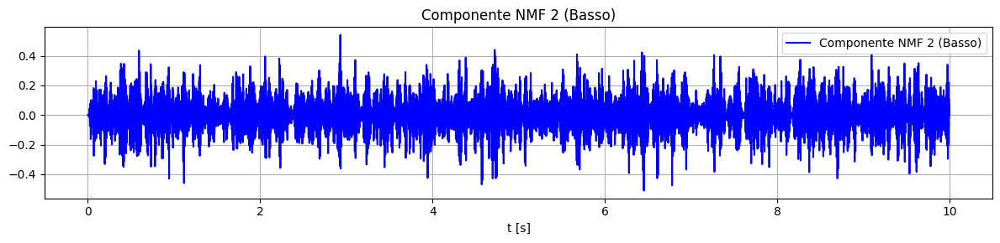

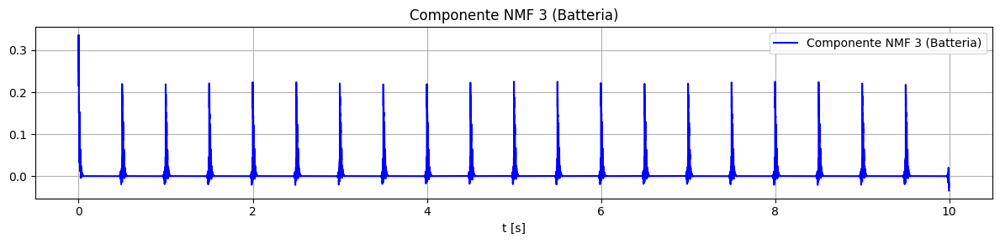

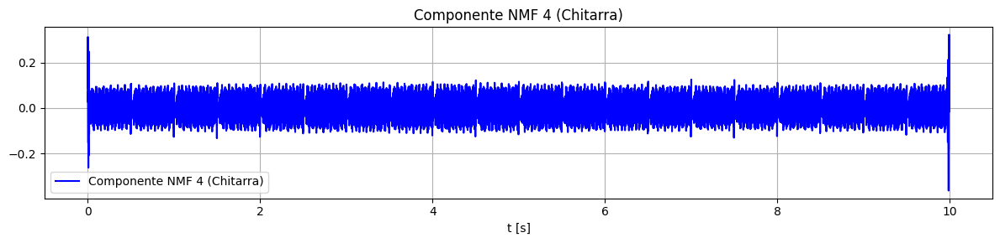

In [37]:
def nmf_decompose(y, sr, n_components=NMF_COMPONENTS, n_fft=2048, hop_length=512,
                  init='random', random_state=0, max_iter=200):
    S = librosa.stft(y, n_fft=n_fft, hop_length=hop_length)
    mag = np.abs(S)
    phase = np.angle(S)
    model = NMF(n_components=n_components, init=init, random_state=random_state, max_iter=max_iter)
    W = model.fit_transform(mag)
    H = model.components_
    total_approx = np.dot(W, H)
    components = []
    reconstructed_signals = []
    for k in range(n_components):
        S_k = np.outer(W[:, k], H[k, :])
        mask = S_k / (total_approx + 1e-10)
        components.append(mask * mag)
        S_k_complex = (mask * mag) * np.exp(1j * phase)
        y_k = librosa.istft(S_k_complex, hop_length=hop_length)
        reconstructed_signals.append(y_k)
    return components, reconstructed_signals


# Eseguiamo NMF e mostra i primi 3 componenti con nomi da INSTRUMENT_NAMES
components, recs = nmf_decompose(y, sr, n_components=NMF_COMPONENTS)
for i, y_k in enumerate(recs):
    ins_name = INSTRUMENT_NAMES[i] if i < len(INSTRUMENT_NAMES) else f'component_{i+1}'
    IPython.display.display(IPython.display.Audio(y_k, rate=sr))
    plot_signal_time(y_k, sr, f'Componente NMF {i+1} ({ins_name})')

Qua abbiamo esattamente ciò che abbiamo descritto prima durante la discussione dei grafici dell'HPSS.

Siamo passati dall'avere due grafici per componente musicale, ad averne 4 per strumento e questo è possibile solo grazie all'NMF. Si può notare inoltre come in realtà l'unico grafico veramente scomposto sia stato il grafico della componente armonica, diviso nei tre strumenti che la componevano, mentre il grafico della componente percussiva è identico a quello della batteria siccome è l'unico componente di quella parte di segnale



---



# 🔹 Wiener Masking - La separazione del segnale
Nel contesto della separazione di sorgenti musicali, l'obiettivo non è rimuovere il rumore casuale, ma isolare uno specifico tipo di strumento, come per esempio le percussioni, dal mix complessivo. Così facendo, tutti gli altri tipi di strumento vengono trattati come un'interferenza e, di conseguenza, filtrati.

---

All'intero del codice la nostra funzione normalizza le magnitudini per generare maschere soft.

magnitude_sources: lista di spettrogrammi (magnitudine)

Alla fine la funzione ritorna maschere normalizzate.

[wiener_masking] stacked.shape = (4, 1025, 862)
[wiener_masking] mask 0 stats: min=0.0000, max=0.9996, mean=0.0141
[wiener_masking] mask 1 stats: min=0.0000, max=0.9614, mean=0.0051
[wiener_masking] mask 2 stats: min=0.0000, max=1.0000, mean=0.1275
[wiener_masking] mask 3 stats: min=0.0000, max=1.0000, mean=0.8533
Riproduco componente 1 (Violino)


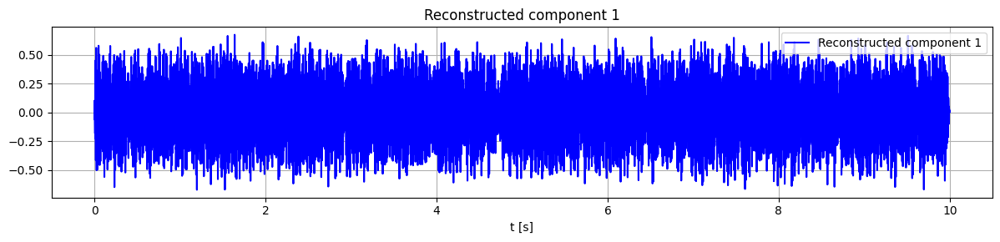

Riproduco componente 2 (Basso)


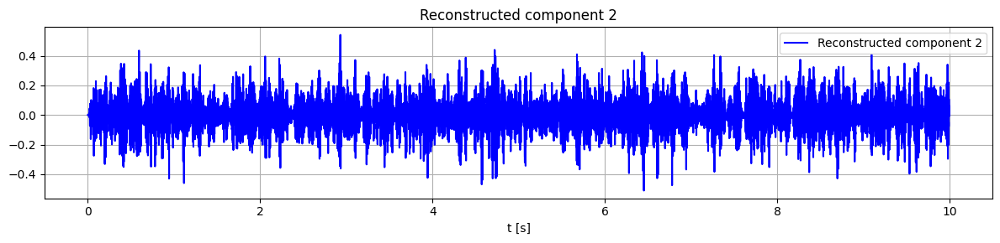

Riproduco componente 3 (Batteria)


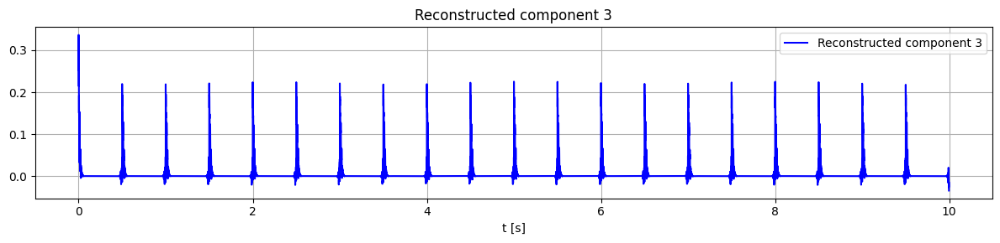

Riproduco componente 4 (Chitarra)


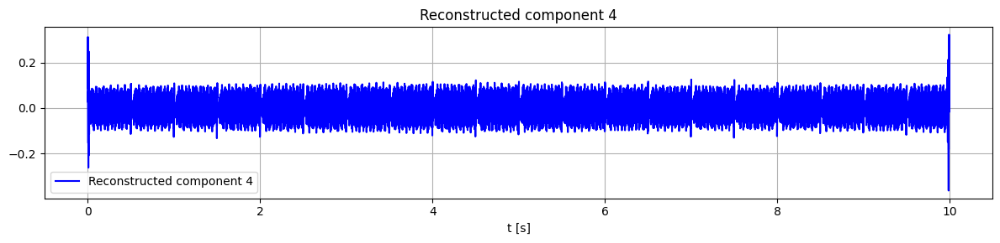

In [38]:
def wiener_masking(magnitude_sources, eps=1e-10):
    # supporta lista
    if isinstance(magnitude_sources, list):
        stacked = np.stack(magnitude_sources, axis=0)
    else:
        stacked = magnitude_sources
    print(f"[wiener_masking] stacked.shape = {stacked.shape}")
    total = np.sum(stacked, axis=0) + eps
    masks = []
    for k in range(stacked.shape[0]):
        mask = stacked[k] / total
        masks.append(mask)
        print(f"[wiener_masking] mask {k} stats: min={mask.min():.4f}, max={mask.max():.4f}, mean={mask.mean():.4f}")
    return masks


def reconstruct_from_masked_mag(masked_mag, phase, hop_length=512):
    S_complex = masked_mag * np.exp(1j * phase)
    y = librosa.istft(S_complex, hop_length=hop_length)
    return y


# applica wiener masking alle magnitudini NMF e riproduce direttamente
S = librosa.stft(y)
mag = np.abs(S)
phase = np.angle(S)
mags = components # magnitudini pre-calcolate dalla NMF
masks = wiener_masking(mags)


# ricostruisci segnali dalle magnitudini mascherate e riproduci senza salvare
reconstructed = []
for i, mag_comp in enumerate(mags):
    y_k = reconstruct_from_masked_mag(mag_comp, phase)
    reconstructed.append(y_k)
    print(f"Riproduco componente {i+1} ({INSTRUMENT_NAMES[i] if i < len(INSTRUMENT_NAMES) else i+1})")
    IPython.display.display(IPython.display.Audio(y_k, rate=sr))
    plot_signal_time(y_k, sr, f'Reconstructed component {i+1}')

## Confronto tra Wiener Masking e Filtri Passa-Basso / Passa-Alto

In questa sezione confrontiamo il **Wiener masking** utilizzato nel progetto con i filtri classici **passa-basso** e **passa-alto**, evidenziando perché il Wiener masking risulta più adatto alla separazione di sorgenti musicali.

---

### Filtri Passa-Basso e Passa-Alto

I filtri passa-basso e passa-alto sono filtri **deterministici in frequenza**, che operano secondo una soglia fissa:

- **Filtro passa-basso (LPF)**  
  Mantiene solo le frequenze inferiori a una certa frequenza di taglio.  
  È utile per eliminare rumore ad alta frequenza, ma tende a:
  - eliminare armoniche importanti
  - rendere il segnale “ovattato”

- **Filtro passa-alto (HPF)**  
  Mantiene solo le frequenze superiori a una certa soglia.  
  È utile per rimuovere ronzio o componenti lente, ma:
  - distrugge la fondamentale degli strumenti
  - altera il timbro musicale

 **Limite principale:**  
Questi filtri **non distinguono le sorgenti**, ma solo le frequenze.  
Due strumenti che condividono la stessa banda (es. chitarra e violino) non possono essere separati efficacemente.

---

### Wiener Masking

Il Wiener masking è un metodo **adattivo** che opera sullo spettrogramma, non su soglie fisse.

Data una stima delle sorgenti $S_k$  , la maschera di Wiener è definita come:

$$\mathbf{M_k(t,f) = \frac{|S_k(t,f)|^2}{\sum_j |S_j(t,f)|^2 + \varepsilon}}$$

Questa maschera:
- è **soft** (continua, non binaria)
- dipende dal contenuto reale del segnale
- assegna ogni punto tempo–frequenza alla sorgente più dominante

Nel codice, il Wiener masking è usato per:
- ridistribuire l’energia spettrale tra le componenti NMF
- preservare la struttura musicale del segnale
- evitare artefatti dovuti a tagli netti in frequenza

---

### Perché nel progetto conviene il Wiener masking

Nel contesto della separazione musicale:
- gli strumenti condividono bande di frequenza
- il contenuto varia nel tempo
- è importante preservare il timbro

Il Wiener masking risulta quindi preferibile perché:
- **non impone soglie rigide**
- **segue la struttura del segnale**
- **si integra naturalmente con NMF**
- produce risultati più naturali all’ascolto

---

### Osservazione finale
Nel progetto si nota che l’effetto del Wiener masking può apparire poco evidente nel dominio del tempo, ma è più chiaro:
- nello spettrogramma
- nell’energia assegnata alle singole componenti

Questo comportamento è coerente con la natura “soft” del metodo e rappresenta un compromesso tra separazione e qualità percettiva.


---

# 🔹 Rimozione di una componente dal segnale originale


 - Questa cella contiene funzioni per selezionare una componente (tra quelle estratte dalla NMF o dall'HPSS) e rimuoverla dal mix originale.
 - La rimozione avviene tramite sottrazione diretta del segnale icostruito della componente (allineamento in durata normalizzazione per evitare clipping).


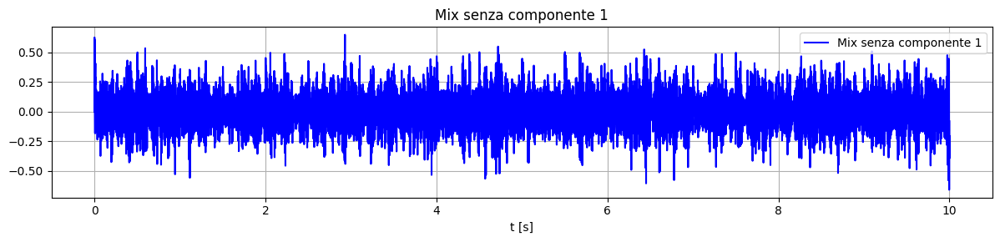

In [39]:
def remove_component_from_mix(original_y, component_y):
    # Sottrae un componente dal mix.
    # Allinea le durate (trim/pad) e sottrae la componente.
    # Normalizza il risultato per evitare clipping.
    # Ritorna il segnale risultante.

    L = min(len(original_y), len(component_y))
    out = original_y.copy()
    out[:L] -= component_y[:L]
    # Se component_y è più corta, il resto di out rimane invariato; se è più lunga, viene troncata.
    mx = np.max(np.abs(out))
    if mx > 1.0:
        out = out / mx
    return out


def show_removed_component_result(original_y, component_y, sr, title_suffix=''):
    # Sottrae component_y da original_y, riproduce e mostra il grafico del risultato."""
    out = remove_component_from_mix(original_y, component_y)
    print(f"Risultato dopo la rimozione{(' - ' + title_suffix) if title_suffix else ''}:")
    IPython.display.display(IPython.display.Audio(out, rate=sr))
    plot_signal_time(out, sr, f'Mix senza componente {title_suffix}')
    return out

#ESEMPIO CON RIMOZIONE DELLA COMPONENTE 1
out_minus_1 = remove_component_from_mix(y, recs[0])
IPython.display.display(IPython.display.Audio(out_minus_1, rate=sr))
plot_signal_time(out_minus_1, sr, 'Mix senza componente 1')

*SE SI VUOLE CAMBIARE LA COMPONENTE DA RIMUOVERE DAL MIX BASTA CAMBIARE IL NUMERO ALL'INTERNO DI 'recs[...]' CON NUMERI CHE VANNO DA 0 A 3*

# 🔹 Conclusione

Per concludere, il progetto mi è servito per applicare concetti come quello della **Trasformata di Fourier** e della **STFT** per avere una visualizzazione concreta di ciò su cui stiamo lavorando e per poterlo visualizzare all'interno del dominio tempo-frequenza.

La cosa più importante è stata però l'applicazione della **NMF** allo spettrogramma che ci ha permesso di riuscire a dividere il segnale in diversi strumenti, ciascuno caratterizzato da una base "spettrale" e da un "ritmo" visualizzabile nel grafico. è bene notare come questi strumenti siano interpretabili grazie a queste due caratteristiche e quindi non rappresentino strumenti reali, però è giusto notare come la **NMF** sia in grado di notare ed interpretare a modo suo queste cose.

Dopodiché è bene parlare del **Wiener-Masking**, un qualcosa di esterno al nostro corso ma che mi ha permesso di ottenere dei risultati ottimali nella ricostruzione del segnale post-NMF. Ho preferito usare questo al posto di un filtro visto a lezione perché, su consiglio di Gemini, l'utilizzo di maschere nel dominio tempo-frequenza si è dimostrato più efficace poiché consente di preservare il contenuto informativo del segnale senza effettuare tagli rigidi in frequenza.

Infine l'ultimo esperimento, quella di rimozione di una componente, è stato quel tocco creativo che volevo dare al mio progetto per manipolare e "giocare" a tutti gli effetti con il segnale originale e poter anche vedere come questo possa essere modificato tramite il codice di questo progetto.

### Limiti che ho trovato
Alcuni risultati mostrano che la separazione non è perfetta: le componenti possono sovrapporsi e contenere residui di altre sorgenti. Questo è un limite intrinseco della NMF non supervisionata e del numero finito di componenti scelto. Inoltre, purtroppo, ho notato come questo esperimento funzioni molto bene con un file auto-generato, mentre invece con un file audio già filtrato funzioni poco siccome il rumore di sottofondo non aiuta il riconoscimento degli strumenti da parte della NMF.
Fortunatamente questi sono gli unici limiti che sono riuscito a trovare durante la realizzazione di questo progetto

### Riflessioni finali

Nel complesso, il progetto ha fornito una comprensione concreta e operativa di concetti teorici fondamentali dell’elaborazione dei segnali, collegando in modo efficace teoria, codice ed esperimenti pratici e in qualche modo anche divertenti.


---

## Fonti e Documentazioni
- A. V. Oppenheim, R. W. Schafer, Discrete-Time Signal Processing
- Steven W. Smith, The Scientist and Engineer’s Guide to DSP
- Filtro di Wiener, Wikipedia
- Librosa documentation  
- Scikit-learn documentation (NMF)
- Gemini AI
- Google AI
- Materiale didattico del corso